In [1]:
import pandas as pd 
import os
import math 
import matplotlib.pyplot as plt
import random 
from sentence_transformers import SentenceTransformer 
from collections import Counter
from umap import UMAP
from sklearn.neighbors import KernelDensity
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from tqdm import tqdm
import numpy as np
import matplotlib.pyplot as plt
from sklearn.neighbors import KernelDensity
import math
import random
import pickle
from threading import Thread 
import uuid
import string
from scipy.stats import entropy


/Users/peetiphartsuebpeng/Documents/CONDA_ENV/env-wizmap/lib/python3.12/site-packages/sentence_transformers/cross_encoder/CrossEncoder.py:11: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm, trange


In [22]:
import warnings
warnings.filterwarnings('ignore')

def generate_random_uid(length=5):
    characters = str(uuid.uuid4())
    uid = ''.join(random.choices(characters, k=length))
    return uid

def Probability(data):
    frequency = Counter(data)
    total_count = sum(frequency.values())
    probability = {char: count / total_count for char, count in frequency.items()}
    
    return probability

def Entropy(data):
    # probability = Probability(data)
    entropy = -sum(p * math.log2(p) for p in data)
    
    return entropy

def plot_Density(umap_model, bandwidth: float = 0.02, ax=None):

    xs = umap_model.embedding_[:,0]
    ys = umap_model.embedding_[:,1]
    X_umap = np.stack((xs, ys), axis=1)
    # Kernel Density Estimation
    kde = KernelDensity(bandwidth=bandwidth)
    kde.fit(X_umap)
    # Create a meshgrid to plot KDE result
    x_min, x_max = X_umap[:, 0].min() - 1, X_umap[:, 0].max() + 1
    y_min, y_max = X_umap[:, 1].min() - 1, X_umap[:, 1].max() + 1
    xx, yy = np.meshgrid(np.linspace(x_min, x_max, 500), np.linspace(y_min, y_max, 500))
    Z = np.exp(kde.score_samples(np.c_[xx.ravel(), yy.ravel()]))
    Z = Z.reshape(xx.shape)
    
    # Plot KDE result on the given axis
    if ax is None:
        plt.figure(figsize=(12,6))
        ax = plt.gca()
        
    contour = ax.contourf(xx, yy, Z, cmap=plt.cm.Blues)
    ax.scatter(xs, ys, alpha=0.2, s=0.1)
    
    entropy = Entropy(Z.reshape((-1,1)).flatten())
    params = umap_model.get_params()
    ax.set_title(f'Entropy Scores: {round(entropy,4)}')
    ax.set_xlabel('UMAP Dimension 1')
    ax.set_ylabel('UMAP Dimension 2')

    return Z.reshape((-1,1)), Z

def get_Density(umap_model, max_sample=100000, SEED=1234, grid_size=200):
    
    xs = umap_model.embedding_[:,0]
    ys = umap_model.embedding_[:,1]
    projected_emb = np.stack((xs, ys), axis=1)

    x_min, x_max = np.min(xs), np.max(xs)
    y_min, y_max = np.min(ys), np.max(ys)
    
    x_gap = x_max - x_min
    y_gap = y_max - y_min
    
    if x_gap > y_gap:
        # Expand the larger range to leave some padding in the plots
        x_min -= x_gap / 50
        x_max += x_gap / 50
        x_gap = x_max - x_min
        
        # Regulate the 2D grid to be a square
        y_min -= (x_gap - y_gap) / 2
        y_max += (x_gap - y_gap) / 2
    else:
        # Expand the larger range to leave some padding in the plots
        y_min -= y_gap / 50
        y_max += y_gap / 50
        y_gap = y_max - y_min
        
        # Regulate the 2D grid to be a square
        x_min -= (y_gap - x_gap) / 2
        x_max += (y_gap - x_gap) / 2
    
    # Estimate on a 2D grid
    grid_xs = np.linspace(x_min, x_max, grid_size)
    grid_ys = np.linspace(y_min, y_max, grid_size)
    xx, yy = np.meshgrid(grid_xs, grid_ys)
    
    grid = np.vstack([xx.ravel(), yy.ravel()]).transpose()

    sample_size = min(max_sample, len(xs))
    n = sample_size
    d = projected_emb.shape[1]
    bw = (n * (d + 2) / 4.)**(-1. / (d + 4))
    
    # We use a random sample to fit the KDE for faster run time
    rng = np.random.RandomState(SEED)
    random_indexes = rng.choice(range(projected_emb.shape[0]),
                                min(projected_emb.shape[0], sample_size),
                                replace=False)
    
    kde = KernelDensity(kernel='gaussian', bandwidth=bw)
    kde.fit(projected_emb[random_indexes, :])
    
    log_density = kde.score_samples(grid)
    log_density = np.exp(log_density)
    grid_density = np.reshape(log_density, xx.shape)
    
    # cfset = ax.contourf(xx, yy, grid_density.round(4),
    #                     levels=np.linspace(0, np.max(grid_density), 20),
    #                     cmap='Blues',
    #                     alpha=1)
    
    return grid_density, xx, yy 

def load_pickle(path): 
    with open(f'{path}', 'rb') as file : 
        rs = pickle.load(file)
    return rs

def extract_data(model_list):
    
    plot_lst = []
    params = []
    for model_i in tqdm(model_list, desc="pack data") :
        
        path = os.path.join(log_path, model_i)
        data_load = load_pickle(path)
        
        density = data_load.get('density').get('grid_density').reshape(-1,1).flatten()
        hist, bin_a = np.histogram(density, bins=1000)
        p = hist / np.sum(hist)
        # entp = -np.sum(p*np.log2(p))
        entp = entropy(p)
        
        n_n = data_load.get('model').get_params().get('n_neighbors')
        md = data_load.get('model').get_params().get('min_dist')
        spd = data_load.get('model').get_params().get('spread')
        
        plot_lst.append({'model_index': data_load.get('model_index') ,
                         'entropy': entp, 
                         'xs': data_load.get('model').embedding_[:,0], 
                         'ys': data_load.get('model').embedding_[:,1],
                         'xx': data_load.get('density').get('xx'),
                         'yy': data_load.get('density').get('yy'),
                         'Z': data_load.get('density').get('grid_density'), 
                         'Z_flatten': density, 
                         'n_neighbors': n_n, 
                         'min_dist':md, 
                         'spread':spd})

        entp = None
        data_load = None
        density = None
        
    # params_lst = []
    # for index,pl in enumerate(plot_lst): 
    #     params_lst.append(index, pl.get('n_neighbors'), pl.get('min_dist'), pl.get('spread'))

    # np.sort(params_lst, order=)
    # plot_lst = sorted(plot_lst, key=lambda x: x['entropy'])
    return plot_lst
    
def generate_scatter_graph(plot_lst, dict_sort):

    entp_list = []
    # num_graphs = len(dict_sort)
    # num_cols = 5
    # num_rows = len(plot_lst) // num_cols
    
    # scatter
    # for i in tqdm(range(num_graphs), desc='generate scatter-graph'):

    #     if i % 5 == 0 : 
    #         fig, axes = plt.subplots(1, 5, figsize=(12,8))
            
    #     row = dict_sort[i]
    #     idx = row.get('index')
    #     data_tmp = plot_lst[idx]
    #     axes[i].contourf(data_tmp.get('xx'), data_tmp.get('yy'), data_tmp.get('Z'), cmap=plt.cm.Blues)
    #     axes[i].scatter(data_tmp.get('xs'), data_tmp.get('ys'), alpha=0.9, s=0.1) 
    #     axes[i].set_title(f"UMAP {data_tmp.get('model_index')} Entropy = {round(data_tmp.get('entropy'), 4)} n_neighbors = {data_tmp.get('n_neighbors')} min_dist = {data_tmp.get('min_dist')} spread = {data_tmp.get('spread')}")
    #     if i % 5 == 0 : 
    #         plt.show()

    n = 4
    datas = [dict_sort[i*n:(i+1)*n] for i in range(len(dict_sort)//n)]
    for batch in datas:
        fig, axes = plt.subplots(1, n, figsize=(40,10))
        for i, elm in enumerate(batch):
            idx = elm.get('index')
            data_tmp = plot_lst[idx]
            axes[i].contourf(data_tmp.get('xx'), data_tmp.get('yy'), data_tmp.get('Z'), cmap=plt.cm.Blues)
            axes[i].scatter(data_tmp.get('xs'), data_tmp.get('ys'), alpha=0.9, s=0.1) 
            axes[i].set_title(f"UMAP {data_tmp.get('model_index')} Entropy = {round(data_tmp.get('entropy'), 4)} n_neighbors = {data_tmp.get('n_neighbors')} min_dist = {data_tmp.get('min_dist')} spread = {data_tmp.get('spread')}")
            entp_list.append(data_tmp.get('entropy'))
        plt.show()


    # range_of_list = len(plot_lst)
    # fig, axes = plt.subplots(nrows=range_of_list, ncols=2, figsize=(15, 5 * range_of_list))  # Adjust figure size as needed
    
    # for i in tqdm(range(range_of_list), desc='generate graph'):

    #     data_tmp = plot_lst[i]
    #     axes[i, 0].hist(data_tmp.get('Z_flatten'), bins=30, color='blue', alpha=0.7)
    #     axes[i, 0].set_title(f'Hist UMAP {data_tmp.get('model_index')} Entropy = {round(data_tmp.get('entropy'), 4)}')
        
    #     axes[i, 1].contourf(data_tmp.get('xx'), data_tmp.get('yy'), data_tmp.get('Z'), cmap=plt.cm.Blues)
    #     axes[i, 1].scatter(data_tmp.get('xs'), data_tmp.get('ys'), alpha=0.9, s=0.1) 
    #     axes[i, 1].set_title(f'Scatter UMAP {data_tmp.get('model_index')} Entropy = {round(data_tmp.get('entropy'), 4)}')
        
    # plt.tight_layout()
    # plt.show()

    return entp_list
        
def plot(x,y,xx,yy,Z):
    
    plt.figure(figsize=(12,6))
    plt.contourf(xx, yy, Z, cmap=plt.cm.Blues)
    plt.scatter(x, y, alpha=0.9, s=0.1) 
    plt.show()

In [23]:
# log_path = './output/model_log3/'
# model_list = os.listdir(log_path)
# model_list = [i for i in model_list if i != ".ipynb_checkpoints"]

# plot_lst = extract_data(model_list)

In [24]:
log_path = './output/model_log3/'
model_list = os.listdir(log_path)
model_list = [i for i in model_list if i != ".ipynb_checkpoints"]

plot_lst = extract_data(model_list)

pack data: 100%|█| 240/240 [00:06<00:00, 39.57i


In [25]:
df_plot = pd.DataFrame(plot_lst)

In [26]:
df_plot = df_plot[['n_neighbors', 'spread', 'min_dist']].sort_values(by=['n_neighbors', 'spread', 'min_dist'])

In [27]:
data_dict = df_plot.reset_index().to_dict('records')

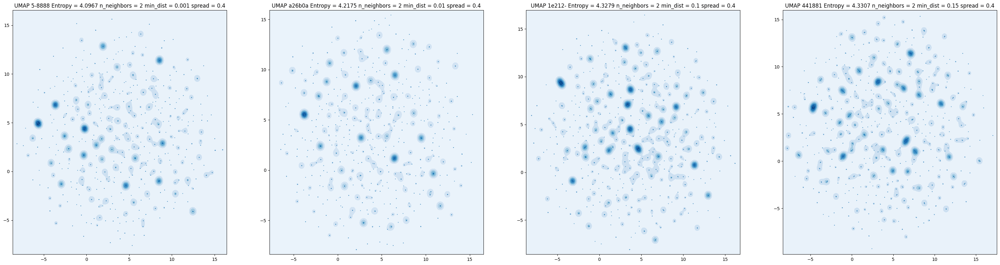

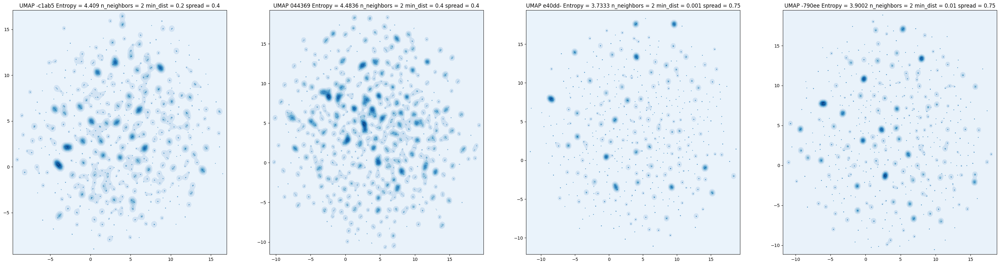

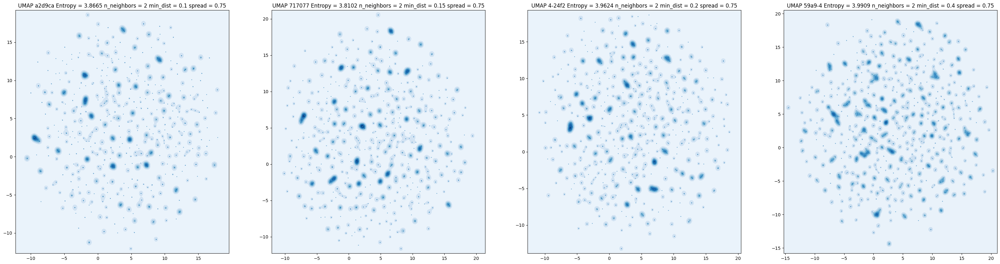

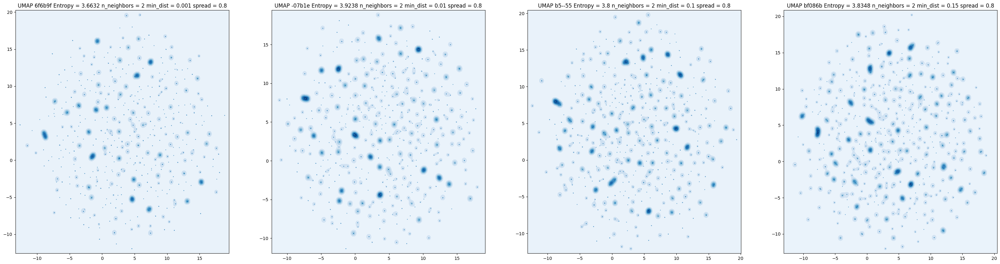

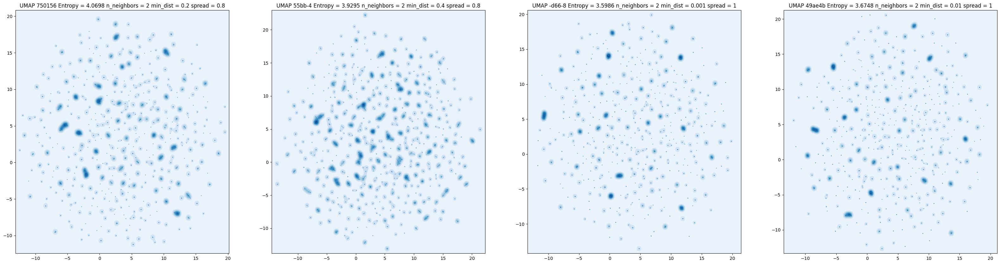

...

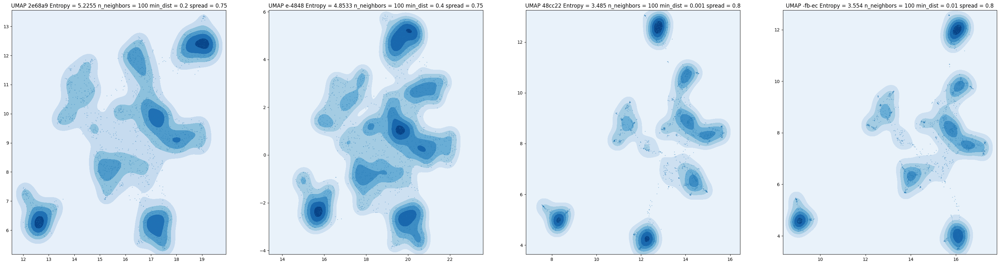

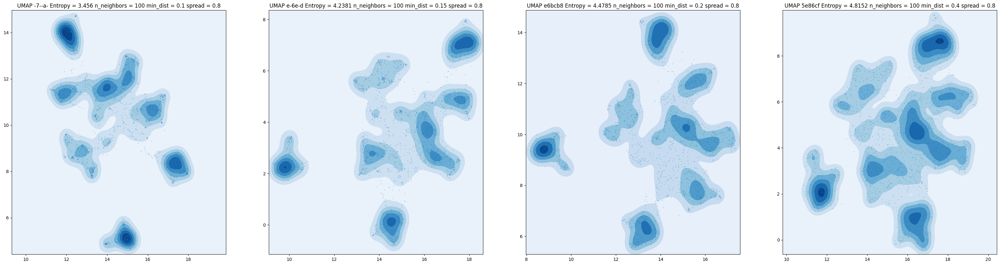

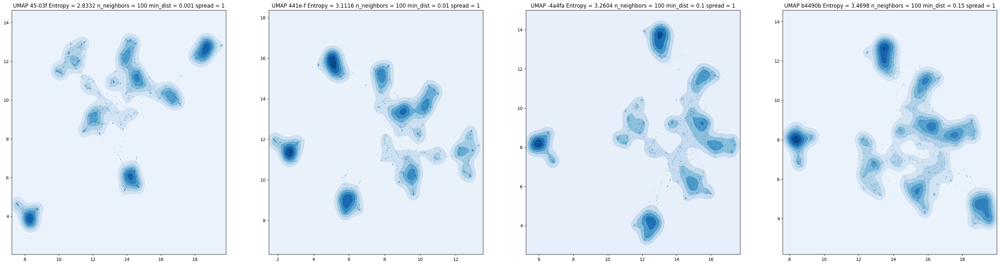

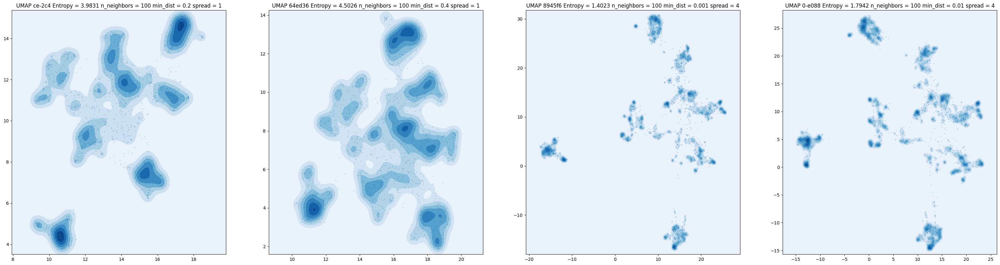

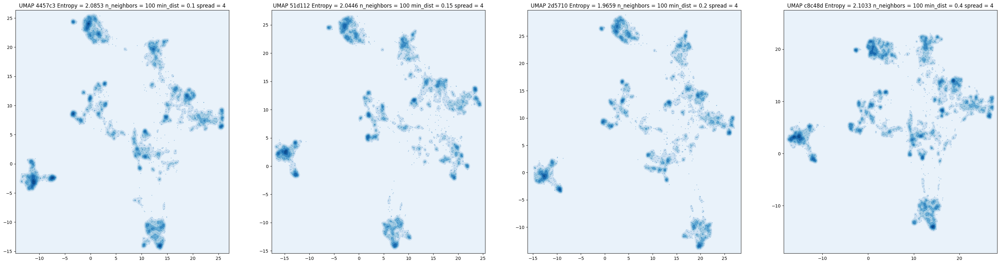

In [28]:
entp_list = generate_scatter_graph(plot_lst, data_dict)

In [29]:
entp_list

[4.096654137918307,
 4.217494494994056,
 4.327903620982386,
 4.3307471347508795,
 4.408992082719849,
 4.483616834405346,
 3.733270722538998,
 3.900213045911796,
 3.8665417744149417,
 3.810153876678222,
 3.9623963546019443,
 3.9909387159592287,
 3.6631965440141454,
 3.923762660326434,
 3.799990059746008,
 3.834753809020529,
 4.069790297396062,
 3.929542972833812,
 3.598617151595349,
 3.674803146607301,
 3.5930292243360635,
 3.7117568979894027,
 3.631483474559952,
 3.539233478691743,
 2.324149673777163,
 2.104133943047011,
 2.258637170847872,
 2.3728798370436044,
 2.334018248505018,
 2.4219729036262754,
 2.261457509402974,
 2.062634740162439,
 2.2454699547953867,
 2.366811152835245,
 2.548643779529054,
 2.453165772446619,
 2.0264948908049405,
 2.004495173092934,
 2.0897220964541177,
 2.49697047780105,
 2.671214720002166,
 2.246067620877398,
 2.088574206637496,
 1.9330791634084032,
 2.3083640757021935,
 2.355419622466738,
 2.459923135641213,
 2.6715466684723284,
 1.8546971081232053,
 1.85

In [ ]:
pd.DataFrame(entp_list)

In [15]:
generate_scatter_graph(plot_lst[120:
                       ])

generate scatter-graph: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 120/120 [00:05<00:00, 23.47it/s]


generate graph: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 120/120 [00:07<00:00, 16.13it/s]


In [7]:
dfadasf

NameError: name 'dfadasf' is not defined

In [ ]:
# generate_graph(plot_lst[:120])

In [ ]:
# generate_graph(plot_lst[120:])

In [ ]:
# generate_scatter_graph(plot_lst)

In [ ]:
data_path = f'{log_path}{model_list[12]}'
tmp = load_pickle(data_path)

x = tmp.get('model').embedding_[:,0]
y = tmp.get('model').embedding_[:,1]
xx = tmp.get('density').get('xx')
yy = tmp.get('density').get('yy')
Z = tmp.get('density').get('grid_density')
xy = np.stack((x, y), axis=1)